# YOLO methode voor kanker detectie (opdracht 3)

### Imports

In [6]:
# File usage
import shutil
import os

# Image loading
from PIL import Image
import cv2

# YOLO model
from ultralytics import YOLO

# Plotting
import matplotlib.pyplot as plt

## YOLO model

De ondestaande code chunks geven de code weer die is gebruikt om een YOLO model te maken dat groepen van tumor cellen kan herkennen. Deze code kan gebruikt worden voor eigen *tumor* afbeeldingen (wanneer deze gemarkeerd zijn en hiervan de coördinaten bekend zijn) of voor andere doeleinden. De code kan waarschijnlijk niet direct worden overgenomen, vooral datapaden en bestandnamen zullen afwijken. De meeste gebruikte mappen en bestanden automatisch aangemaakt, als maar de correcte data beschikbaar is.

De resultaten uit het model, gemaakt met de onderstaande code, worden besproken in het kopje **Resultaten**. Hier wordt een beeld geschetst van wat het model kan opleveren.

De ondestaande code maakt een dict die alle coördinaten bevat van de gemarkeerde gebieden van elke patiënt/afbeelding.

In [8]:
patient_coords = {}
# The file containing the coördinates is loaded
with open("coords-idc.txt", "r") as file:
    for line in file:
        line = line.strip()
        line = line.split(",")
        # If the patient has not been added
        if not line[0] in patient_coords:
            # An empty list is made
            patient_coords[line[0]] = []
        # The coördinates are added to the dict (key = patient)
        patient_coords[line[0]] += [line[1:]]

In [9]:
print(patient_coords)

{'8863': [['1092', '993', '1377', '1226'], ['1440', '986', '1736', '1275'], ['1585', '1393', '1870', '1727'], ['1126', '1519', '1425', '1664']], '8864': [['1807', '2092', '2570', '2487'], ['1616', '2562', '2489', '2845']], '8865': [['1688', '588', '2118', '772'], ['1995', '845', '2153', '1064']], '8867': [['543', '841', '1176', '1350']], '8913': [['341', '1183', '579', '1318'], ['636', '1150', '850', '1380'], ['743', '1425', '920', '1524'], ['657', '1598', '887', '1791']], '8914': [['2686', '1547', '3181', '1895']], '8916': [['116', '163', '411', '315'], ['864', '167', '1117', '264'], ['318', '918', '665', '1115'], ['364', '870', '516', '1019']], '8917': [['476', '251', '1498', '1111']], '8918': [['1275', '1231', '1517', '1414'], ['1485', '1128', '1724', '1267'], ['794', '1823', '1160', '2093'], ['1533', '1827', '1926', '1990']], '8950': [['429', '581', '930', '1003'], ['1471', '1277', '1768', '1571']], '8951': [['1291', '775', '1967', '1346']], '8955': [['1155', '549', '1619', '1263']

De volgende code maakt de mappen aan waarin de afbeeldingen en label bestanden (bestanden met informatie over de gemarkeerde gebieden) worden geplaatst.

In [10]:
os.makedirs("dataset/images/train", mode=0o777, exist_ok=True)
os.makedirs("dataset/images/val", mode=0o777, exist_ok=True)
os.makedirs("dataset/labels/train", mode=0o777, exist_ok=True)
os.makedirs("dataset/labels/val", mode=0o777, exist_ok=True)

De opvolgende functie en code worden gebruikt om voor elke patiënt/afbeelding, waarop het model getraind wordt, een label file te maken. Vervolgens worden deze label files en de afbeeldingen aan de eerder gemaakte mappen structuur toegevoegd, zodat deze gebruikt kunnen worden om het model te trainen.

In [11]:
def make_line(coord, width, height):
    """
    For every combination of coördinates the correct line for
    the label data file is made.
    : param coord: a list containing x_min, y_min, x_max and y_max
    in this specific order
    : param width: width of the picture containing the surrounded
    area (int)
    : param height: height of the picture containing the surrounded
    area (int)
    : return line: string with the correct format for the label file
    """
    # All strings are coverted to integers
    x_min = int(coord[0])
    x_max = int(coord[2])
    y_min = int(coord[1])
    y_max = int(coord[3])
    # The needed values are calculated
    xcenter = (x_min+x_max)/(2*width)
    ycenter = (y_min+y_max)/(2*height)
    width_b = (x_max-x_min)/width
    height_b = (y_max-y_min)/height
    # The valules are added to a string in the correct order
    line = f"1 {xcenter} {ycenter} {width_b} {height_b}\n"
    return line

In [12]:
# All the pictures/patients names are collected
patients = os.listdir("complete_images")
counter = 0

# Every picture needs a label file
for patient_file in patients:
    counter += 1
    # The patient name is separated from the file name
    patient = patient_file.split(".")[0]
    # Skipping the loop if the patient is not in the coords file
    if not patient in patient_coords: 
        continue
    # Gather the coordinates for the patient/picture
    coords = patient_coords[patient]
    # Getting the width and height of the whole picture
    im = Image.open(f"complete_images/{patient_file}")
    width = im.width
    height = im.height
    # Every fifth patient is used for validation
    if counter == 5:
        # The label file is made in the val folder
        with open(f"dataset/labels/val/{patient}.txt", "w") as output:
            for coord in coords:
                # All the needed input values are added to the file
                line = make_line(coord, width, height)
                output.write(line)
        # The original image is copied and added to the image folder
        shutil.copy(f"complete_images/{patient_file}", f"dataset/images/val/{patient}.jpeg")
        # Reset the counter to seperate the data correctly
        counter = 0

    # The other patients are used to train the model
    else:
        # The label file is made in the train folder
        with open(f"dataset/labels/train/{patient}.txt", "w") as output:
            for coord in coords:
                # All the needed input values are added to the file
                line = make_line(coord, width, height)
                output.write(line)
        # The original image is copied and added to the image folder
        shutil.copy(f"complete_images/{patient_file}", f"dataset/images/train/{patient}.jpeg")

Er is ervoor gekozen om gebruik te maken van een 80/20 verhouding voor de train en val folders. Hierdoor wordt steeds de 5de patiënt/afbeelding gebruikt voor validatie, waarna de teller wordt gereset. Deze verhouding wordt veel gebruikt bij machine learning, waardoor voor deze verhouding is gekozen. Echter kan deze verhouding worden gemakkelijk worden veranderd, door de waarde van de if statement te verlagen of te verhogen. <br>
Ook wordt ervoor gekozen om een kopie van de afbeeldingen in de dataset folders te zetten. Op deze manier wordt er niks veranderd aan de originele input bestanden, waardoor deze input data later voor andere doeleinde gebruikt kan worden. <br>
Tot slot worden de bestanden zonder coördinaten niet toegevoegd aan de dataset folder. Dit maakt het controleren van de output gemakkelijker, aangezien elke file een gebied met tumor cellen moet hebben. Daarnaast is niet zeker of een model getraind kan worden op een afbeelding zonder een gemarkeerd gebied, waardoor dit geheel wordt vermeden in onze code.

Hierna wordt de yaml file gemaakt die nodig is voor het trainen van het model. Het model kan met deze file de correcte folders vinden en de correcte markering doen. <br>
Voor eigen gebruik moeten de train en val datapaden worden veranderd. Hierbij moeten de gehele paden worden gebruikt, anders is het model niet in staat om de folders te vinden.

In [13]:
with open("dataset.yaml", "w") as output:
    output.write("train: /Users/gielb/Desktop/Bio-informatica/leerjaar_3_1/Beeldverwerking/dataset/images/train/\n")
    output.write("val: /Users/gielb/Desktop/Bio-informatica/leerjaar_3_1/Beeldverwerking/dataset/images/val/\n")
    output.write("\n")
    output.write("nc: 1\n")
    output.write("names: ['tumor']\n")

Met de afbeeldingen, yaml en label bestanden wordt het model getraind. Hierbij wordt een model ingeladen dat gemarkeerde gebieden kan herkennen en deze vervolgens kan gebruiken voor training. De single_cls moet op True staan om het model correct te trainen.

In [87]:
model = YOLO("yolov8n.pt")
model.train(data='dataset.yaml', epochs=10, single_cls=True)

Ultralytics 8.3.51  Python-3.10.7 torch-2.5.1+cpu CPU (Intel Core(TM) i7-1065G7 1.30GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=True, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, l

train: Scanning C:\Users\gielb\Desktop\Bio-informatica\leerjaar_3_1\Beeldverwerking\dataset\labels\train... 226 images, 0 backgrounds, 0 corrupt: 100%|██████████| 226/226 [00:01<00:00, 197.45it/s]


train: New cache created: C:\Users\gielb\Desktop\Bio-informatica\leerjaar_3_1\Beeldverwerking\dataset\labels\train.cache


val: Scanning C:\Users\gielb\Desktop\Bio-informatica\leerjaar_3_1\Beeldverwerking\dataset\labels\val... 51 images, 0 backgrounds, 1 corrupt: 100%|██████████| 51/51 [00:00<00:00, 245.96it/s]

val: WARNING  C:\Users\gielb\Desktop\Bio-informatica\leerjaar_3_1\Beeldverwerking\dataset\images\val\12906.jpeg: ignoring corrupt image/label: negative label values [-0.01490367 -0.35914212 -0.03647843 -0.22464558 -0.3882848 ]
val: New cache created: C:\Users\gielb\Desktop\Bio-informatica\leerjaar_3_1\Beeldverwerking\dataset\labels\val.cache
Plotting labels to runs\detect\train\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      2.771      4.113       2.69          6        640: 100%|██████████| 15/15 [01:55<00:00,  7.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.34s/it]

                   all         50        152     0.0042      0.414     0.0111    0.00333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G       2.51      3.598      2.245          3        640: 100%|██████████| 15/15 [02:46<00:00, 11.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.59s/it]

                   all         50        152    0.00407      0.401     0.0426     0.0097



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G       2.49      3.545      2.283          4        640: 100%|██████████| 15/15 [01:39<00:00,  6.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:09<00:00,  4.55s/it]

                   all         50        152    0.00433      0.428     0.0254    0.00642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      2.509      3.292      2.159          5        640: 100%|██████████| 15/15 [01:33<00:00,  6.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:09<00:00,  4.61s/it]

                   all         50        152     0.0042      0.414    0.00899    0.00229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G      2.511      3.199      2.023          4        640: 100%|██████████| 15/15 [01:32<00:00,  6.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.50s/it]

                   all         50        152      0.208      0.125      0.065     0.0145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      2.557        3.1      2.139          4        640: 100%|██████████| 15/15 [01:36<00:00,  6.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:10<00:00,  5.23s/it]

                   all         50        152      0.175      0.164     0.0937     0.0238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      2.414      2.938      2.076          4        640: 100%|██████████| 15/15 [01:40<00:00,  6.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:10<00:00,  5.01s/it]

                   all         50        152      0.191      0.151     0.0728     0.0251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G      2.376       2.91      2.048          6        640: 100%|██████████| 15/15 [01:38<00:00,  6.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:09<00:00,  4.81s/it]

                   all         50        152      0.178      0.224      0.119     0.0446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      2.334      2.898      1.945          3        640: 100%|██████████| 15/15 [01:44<00:00,  6.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:10<00:00,  5.02s/it]

                   all         50        152       0.23      0.158     0.0977     0.0298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G      2.306       2.79      1.913          3        640: 100%|██████████| 15/15 [01:48<00:00,  7.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.63s/it]

                   all         50        152       0.24      0.185      0.128     0.0416



10 epochs completed in 0.336 hours.
Optimizer stripped from runs\detect\train\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train\weights\best.pt, 6.2MB

Validating runs\detect\train\weights\best.pt...
Ultralytics 8.3.51  Python-3.10.7 torch-2.5.1+cpu CPU (Intel Core(TM) i7-1065G7 1.30GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:10<00:00,  5.22s/it]


                   all         50        152      0.178      0.224      0.119     0.0446
Speed: 3.0ms preprocess, 102.2ms inference, 0.0ms loss, 28.0ms postprocess per image
Results saved to runs\detect\train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000029B87CC1F00>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([0.        , 0.001001  , 0.002002  , 0.003003  , 0.004004  ,
       0.00500501, 0.00600601, 0.00700701, 0.00800801, 0.00900901,
       0.01001001, 0.01101101, 0.01201201, 0.01301301, 0.01401401,
       0.01501502, 0.01601602, 0.01701702, 0.01801802, 0.01901902,
       0.02002002, 0.02102102, 0.02202202, 0.02302302, 0.02402402,
       0.02502503, 0.02602603, 0.02702703, 0.02802803, 0.02902903,
       0.03003003, 0.03103103, 0.03203203, 0.03303303, 0.03403403,
       0.03503504, 0.03603604, 0.03703704, 0.03803804, 0.03903904,
       0.04004004, 0.04104104, 0.04204204, 0.04304304, 0.04404404,
       0.04504505, 0.04604605, 0.04704705, 0.048048

Voor het trainen van het model is eerst geprobeerd om met 4 epochs te werken. Helaas geeft het 'beste' model hierna nooit een resultaat terug, omdat hij niet in staat is om een groep tumor cellen te herkennen. Hierna is het model getraind met 10 epochs, waarna het model de gewenste resultaten terug gaf. <br>
Het model is niet op andere hoeveelheden epochs getraind, waardoor de kans bestaat dat het beter presteerd met bijvoorbeeld 15 epochs. Maar wegens overfitting en een te kort aan tijd, is ervoor gekozen om de opvolgende code te runnen met het model getraind op 10 epochs.

### Model evaluatie

Bij het trainen wordt een model gevormd onder de naam 'best.pt'. Dit model wordt ingeladen en gebruikt om van random afbeeldingen de tumor gebieden te markeren.

In [96]:
best_model = YOLO("runs/detect/train/weights/best.pt")

Het model voorspelt de gebieden met tumor cellen van de eerste 10 afbeeldingen uit de val folder. Deze afbeeldingen zijn niet gebruikt bij het trainen, waardoor overfitting (hopelijk) geen rol speelt bij de gemaakte voorspellingen. <br>
Door save op True te zetten, slaat het model de afbeelding met de gemarkeerde gebieden in de runs/detect/predict folder op. Hierdoor hoeven de afbeeldingen niet zelf gemaakt te worden. Daarnaast worden alleen de gemarkeerde gebieden met een cofidence van 0.5 of hoger weergegeven. Hierdoor worden de gebieden waar het model echt niet zeker van is weggefilterd, terwijl de meeste gemarkeerde gebieden op deze manier overblijven. Deze waarde kan worden verhoogd (of verlaagd) wanneer dit gewenst is voor eigen doeleinde.

In [97]:
example_image = [f"dataset/images/val/{file}" for file in os.listdir("dataset/images/val")]
results = best_model.predict(example_image[:10], save=True, conf=0.5)


0: 640x640 7 tumors, 89.5ms
1: 640x640 4 tumors, 89.5ms
2: 640x640 4 tumors, 89.5ms
3: 640x640 (no detections), 89.5ms
4: 640x640 (no detections), 89.5ms
5: 640x640 4 tumors, 89.5ms
6: 640x640 6 tumors, 89.5ms
7: 640x640 2 tumors, 89.5ms
8: 640x640 2 tumors, 89.5ms
9: 640x640 1 tumor, 89.5ms
Speed: 3.4ms preprocess, 89.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict3


## Resultaten

De onderstaande resultaten zijn gemaakt met de bovenstaande code. Deze afbeeldingen zijn te vinden in de results folder op de github pagina (https://github.com/DemiOever/casus_d). De volgende resultaten dienen alleen als demonstratie en worden niet gebruikt om biologische conclusies uit te halen.

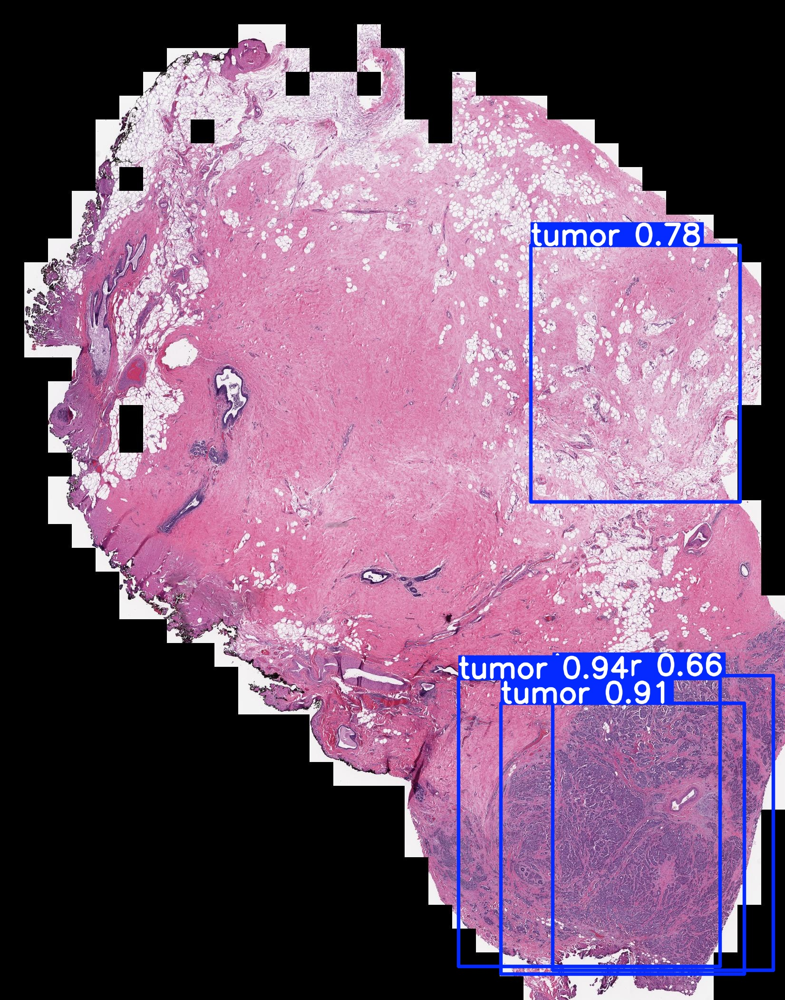

In [117]:
im = Image.open("results/10295.jpg")
im

De bovenstaande afbeelding is een **goed** resultaat gemaakt door het model. Ondanks dat de bovenste gemarkeerde gebied waarschijnlijk niet correct voorspeld is, zijn de onderstaande gebieden dit waarschijnlijk wel. Ook is de zekerheid zeer hoog, waardoor deze gebieden zelfs bij een hoger ingestelde confidence zullen overblijven. 

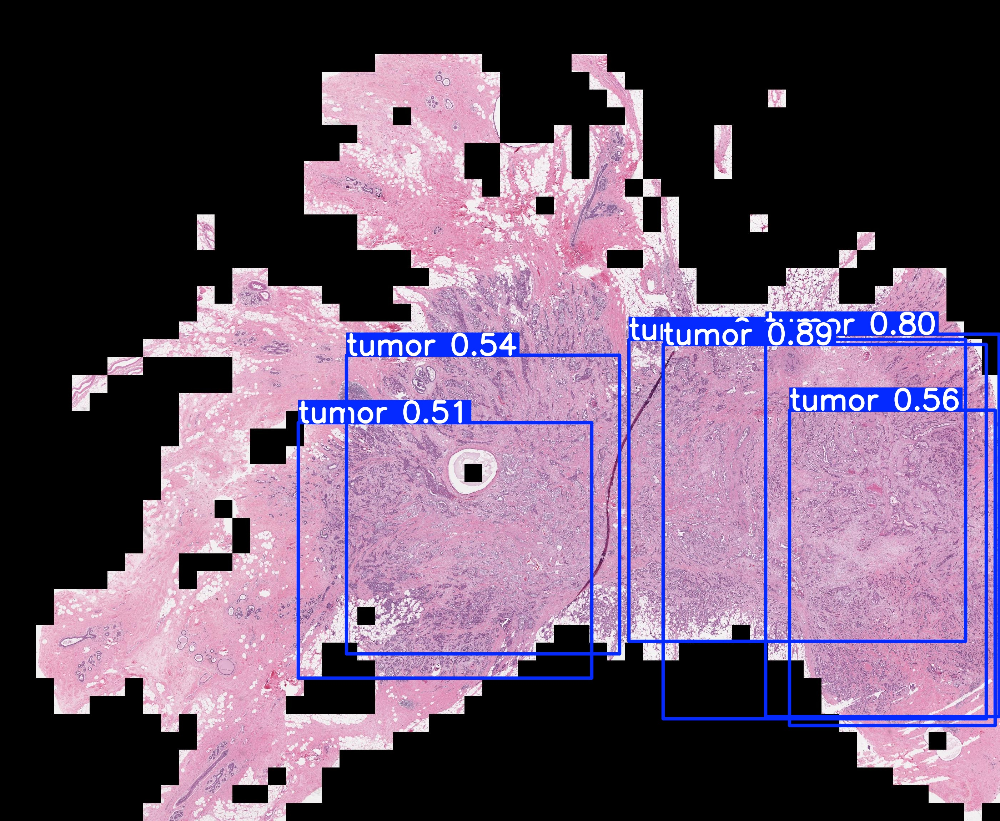

In [3]:
im = Image.open("results/10303.jpg")
im

Deze voorspelling is **lastig** te controleren. Op elke afbeelding zou een gebied met tumorcellen aanwezig moeten zijn. De kans bestaat dat het model deze gemarkeerd heeft, alleen is het voor ons lastig om dit exact te controleren. Een patholoog zou dit resultaat kunnen gebruiken, maar moet eerst controleren of bijvoorbeeld het linker gebied wel of geen tumor gebied is.

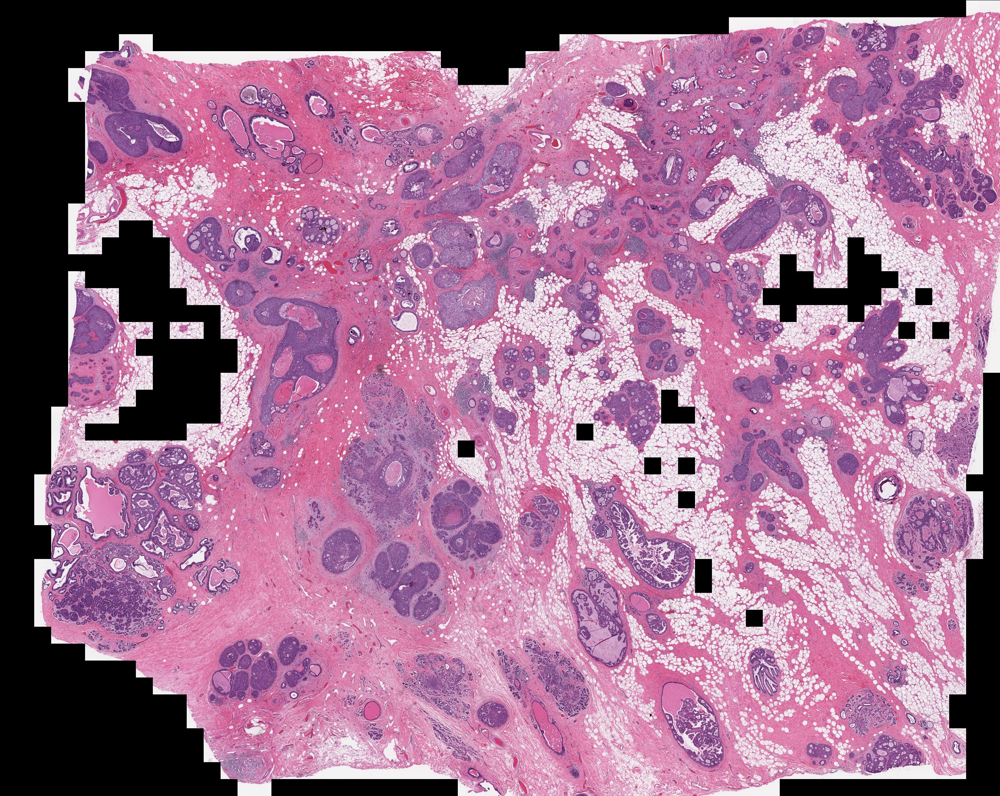

In [4]:
im = Image.open("results/10288.jpg")
im

Helaas geeft het model ook resultaten die **incorrect** zijn. Zoals eerder vermeldt bevatten alle geteste afbeeldingen gebieden met tumorcellen. Dat het model geen resultaat teruggeeft kan twee dingen betekenen:
1. Het model heeft geen gebieden gevonden die op tumor gebieden lijken
2. Het model heeft wel een tumor gebied gevonden, alleen is de zekerheid zo laag dat deze weggefilterd is bij de confidence stap.


### **Conclusie**

Het model zou met meer input waarde, een andere train/val verhouding, of met meer epoch getraind kunnen worden voor mogelijk betere resultaten. Voor nu geeft het model geloofwaardige resultaten, waardoor er voor nu geen verdere veranderingen aangebracht gaan worden.